In [18]:
import os
import copy
import json
import shutil
import argparse

import cv2
import glob
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import torch

from tqdm import tqdm
from natsort import natsorted
from IPython.display import display
from typing import Optional, List, Dict, Tuple

In [19]:
def crop_image(img: np.ndarray, crop_percent: int = 10) -> np.ndarray:
    """
    Crop 10% of the image length from both left and right sides.

    Args:
        img: Input image (NumPy array).

    Returns:
        Cropped image (NumPy array).
    """
    if img is None:
        raise ValueError("Input image is None.")

    # Get the dimensions of the input image
    height, width, _ = img.shape

    # Calculate the number of pixels to crop from each side (10% of the width)
    crop_width = width // crop_percent

    # Crop the image
    cropped_img = img[:, crop_width:-crop_width]

    return cropped_img


def resize_image(img: np.ndarray, new_shape: Tuple = (160, 224)) -> np.ndarray:
    return cv2.resize(img, (new_shape[1], new_shape[0]))


def select_major_emotion(emotion_vector: np.array) -> np.array:
    """
    Returns the major emotion based on significance while retaining the original order.

    :param emotion_vector: List of binary values representing emotions.
    :return: A new binary vector with only the major emotion set to 1.
    """

    # Original order of emotions
    original_order = ["Curiosity", "Uncertainty", "Excitement", "Happiness",
                     "Surprise", "Disgust", "Fear", "Frustration"]

    # New order of significance
    new_order = ["Happiness", "Excitement", "Disgust", "Fear", "Frustration",
                 "Surprise", "Curiosity", "Uncertainty"]

    # Extract emotions from initial vector
    indicated_emotions = [original_order[i] for i, e in enumerate(emotion_vector) if e == 1]

    # Determine the most significant emotion from the new order
    for emotion in new_order:
        if emotion in indicated_emotions:
            major = emotion
            break

    # Create and return the new vector based on original order
    return np.array([1 if emotion == major else 0 for emotion in original_order])

In [20]:
crop_percent = 10
new_shape = (160, 224)
major_emotion = True

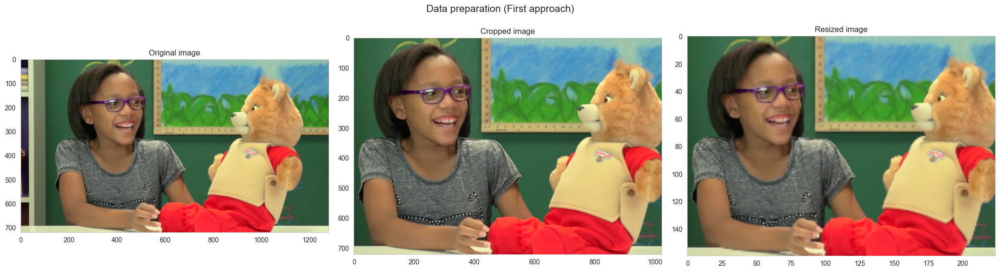

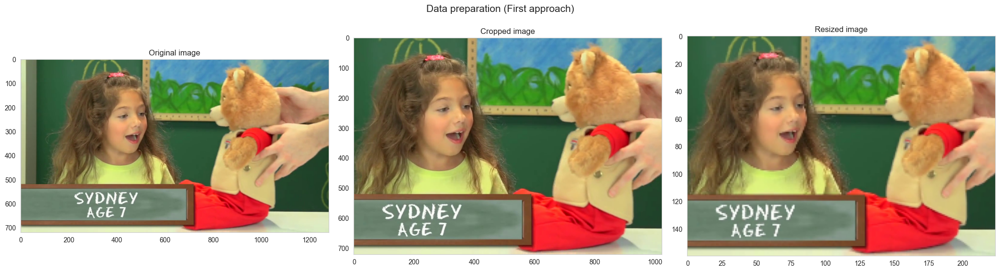

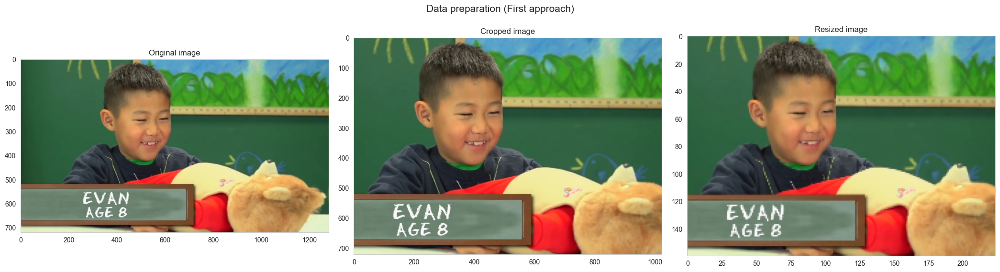

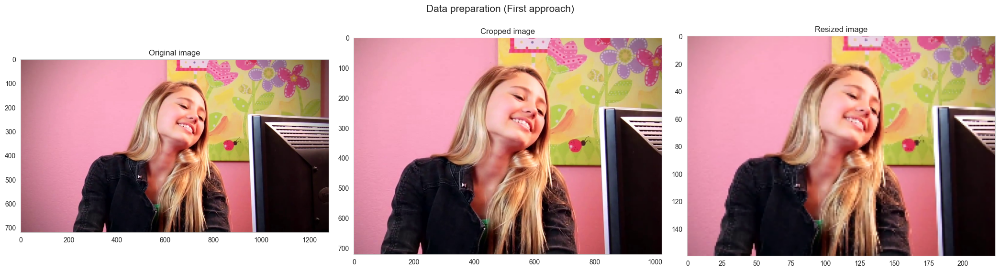

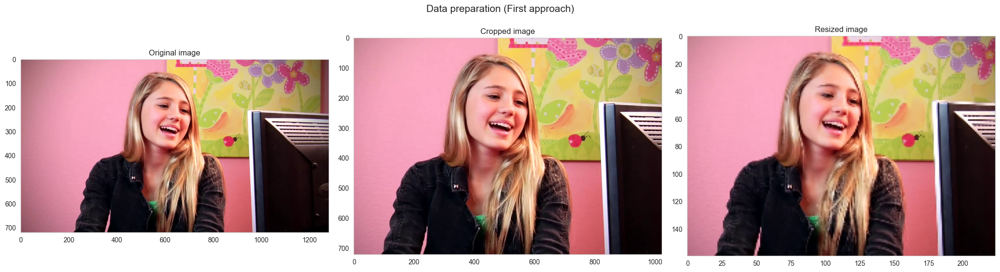

...

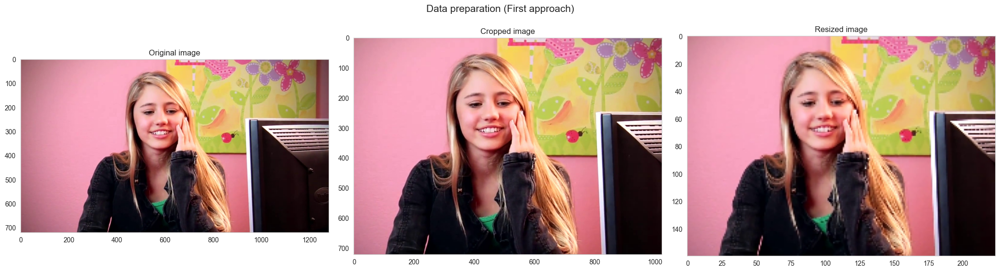

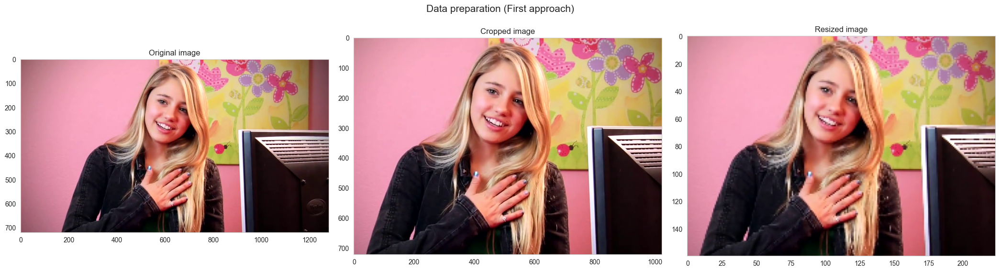

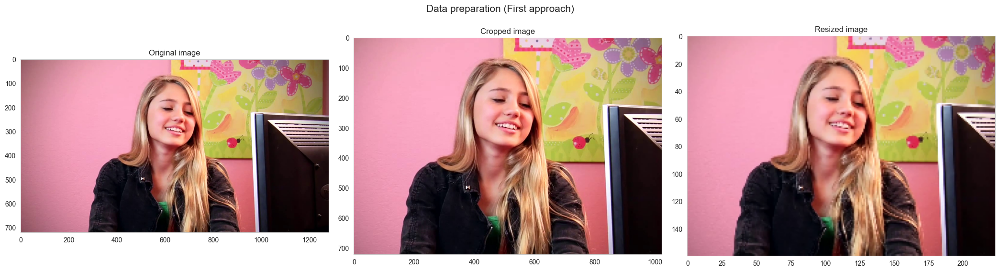

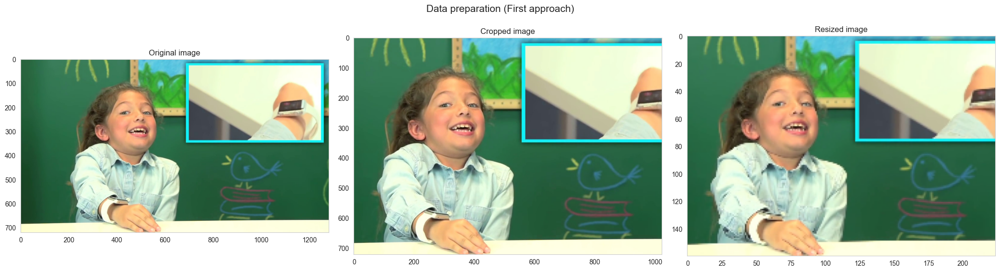

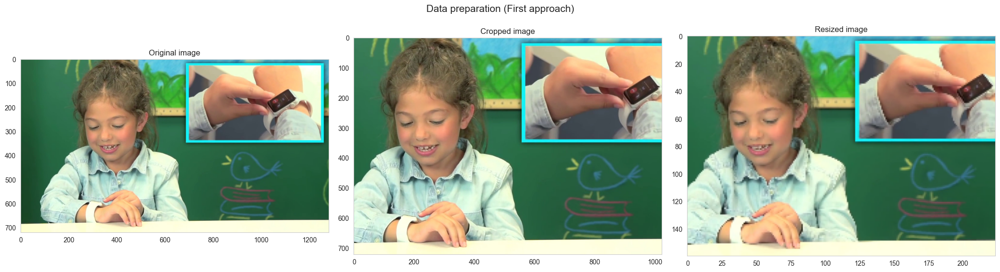

In [23]:
with open(os.path.join(os.path.dirname(os.getcwd()), 'data_path_config.json'), 'r') as file:
    config = json.load(file)

path_to_save_datasets = os.path.join(os.getcwd(), 'datasets')
os.makedirs(path_to_save_datasets, exist_ok=True)

specific_path = os.path.join(path_to_save_datasets,
                             f"{crop_percent}_perc_crop_{'_'.join([str(el) for el in new_shape])}_shape")
if major_emotion:
    specific_path += "_major_emotion"
os.makedirs(specific_path, exist_ok=True)

data_split_types = [os.path.basename(el).split('.')[0] for el in
                    glob.glob(os.path.join(config["datasets_videos"], "*.csv"))]

# for split_type in data_split_types:
split_type = data_split_types[0]
dataset_name = f"{split_type}_dataset"

df = pd.read_csv(os.path.join(config["datasets_images"], f"{split_type}.csv"))
image_folder_path_list = df["file_path"].to_list()

dataset_data = []
for img_idx, img_folder in enumerate(image_folder_path_list[5:20]):
    _label = np.array(df.iloc[img_idx, 1:-1].values, dtype=int)
    if np.max(_label) != 0:
        if major_emotion:
            _label = select_major_emotion(emotion_vector=_label)

        fig, ax = plt.subplots(1, 3, figsize=(21, 6))
        for _img_path in natsorted(glob.glob(os.path.join(img_folder, "*.jpg")))[4:6]:
            img = cv2.imread(_img_path)
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            ax[0].imshow(img)
            ax[0].grid(False)
            ax[0].set_title("Original image")

            # Crop image
            img = crop_image(img=img, crop_percent=crop_percent)
            ax[1].imshow(img)
            ax[1].grid(False)
            ax[1].set_title("Cropped image")

            # Resize image
            img = resize_image(img=img, new_shape=new_shape)
            ax[2].imshow(img)
            ax[2].grid(False)
            ax[2].set_title("Resized image")

            # Set the main title for all subplots
        plt.suptitle("Data preparation (First approach)", size=15)
        plt.tight_layout()
        plt.subplots_adjust(top=0.95)  # Adjust the top so the suptitle fits within the figure window
        plt.show()

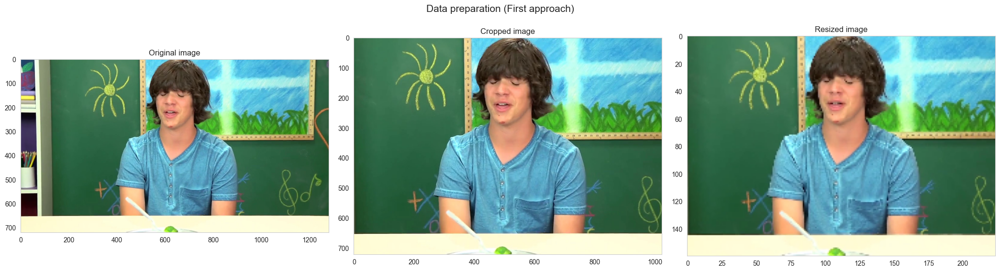

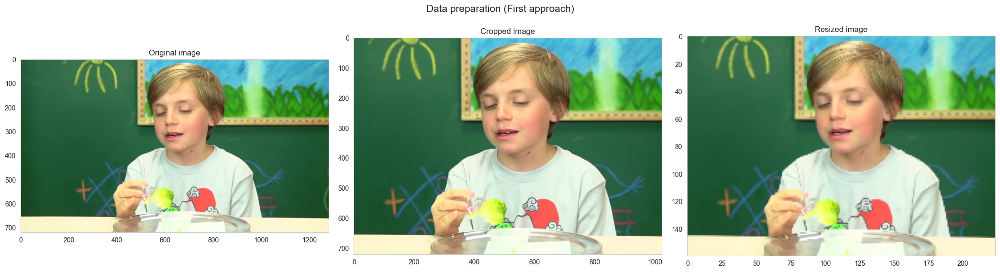

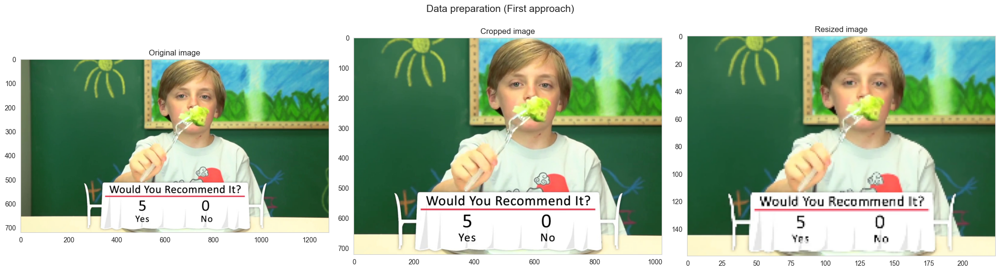

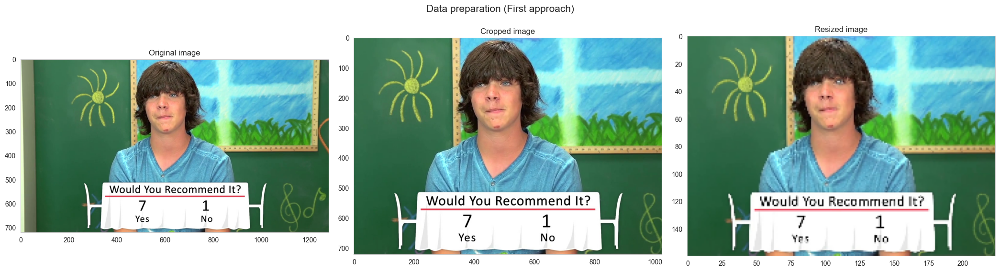

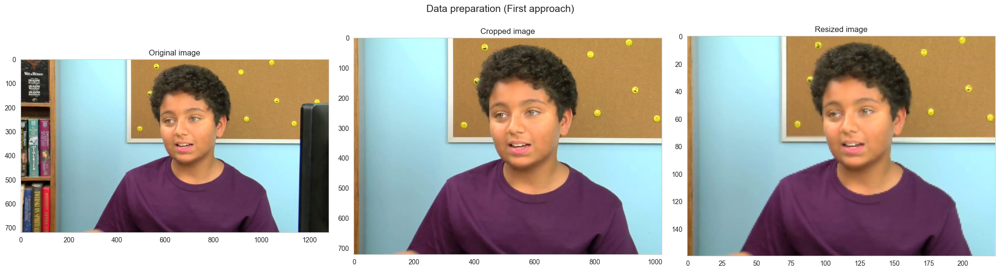

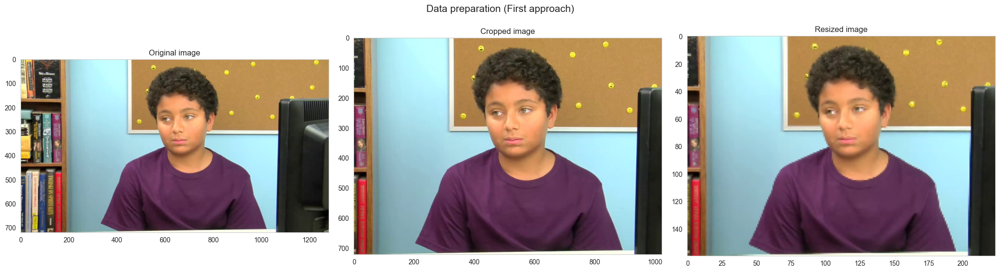

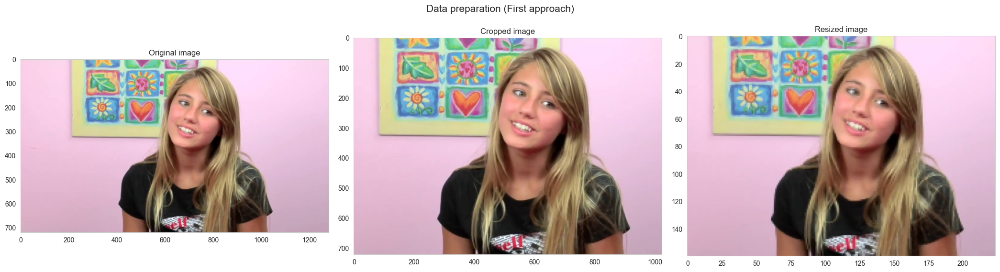

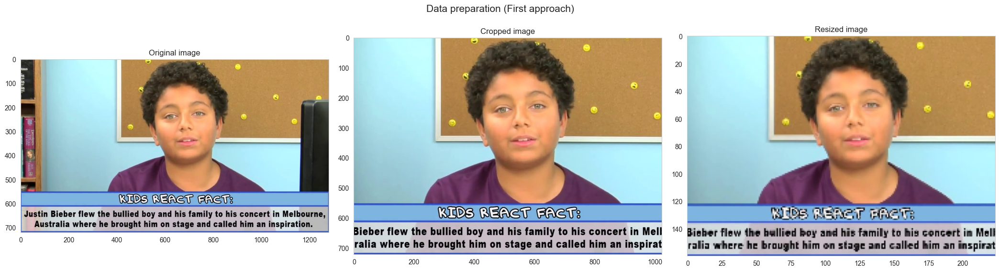

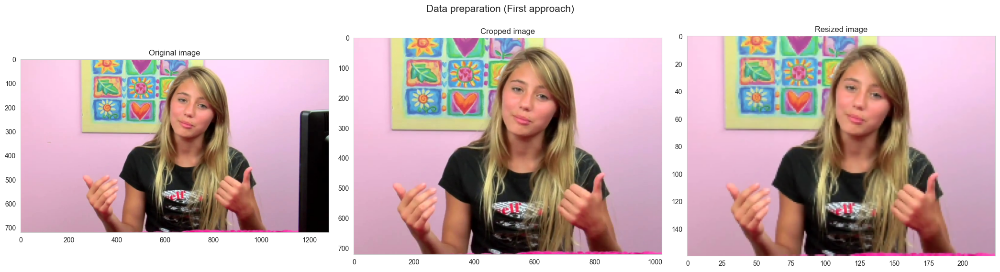

In [24]:
for img_idx, img_folder in enumerate(image_folder_path_list[35:45]):
    _label = np.array(df.iloc[img_idx, 1:-1].values, dtype=int)
    if np.max(_label) != 0:
        if major_emotion:
            _label = select_major_emotion(emotion_vector=_label)

        fig, ax = plt.subplots(1, 3, figsize=(21, 6))
        for _img_path in natsorted(glob.glob(os.path.join(img_folder, "*.jpg")))[4:6]:
            img = cv2.imread(_img_path)
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            ax[0].imshow(img)
            ax[0].grid(False)
            ax[0].set_title("Original image")

            # Crop image
            img = crop_image(img=img, crop_percent=crop_percent)
            ax[1].imshow(img)
            ax[1].grid(False)
            ax[1].set_title("Cropped image")

            # Resize image
            img = resize_image(img=img, new_shape=new_shape)
            ax[2].imshow(img)
            ax[2].grid(False)
            ax[2].set_title("Resized image")

            # Set the main title for all subplots
        plt.suptitle("Data preparation (First approach)", size=15)
        plt.tight_layout()
        plt.subplots_adjust(top=0.95)  # Adjust the top so the suptitle fits within the figure window
        plt.show()